<a href="https://colab.research.google.com/github/TIANBOQIU/AppliedDeepLearning/blob/master/HW3_final.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Assignment 3

**Experiment with hyperparameters**

**Tianbo Qiu (tq2137) **

In [1]:
!pip install -q tf-nightly-2.0-preview
%load_ext tensorboard.notebook

    100% |████████████████████████████████| 80.1MB 541kB/s 
    100% |████████████████████████████████| 3.0MB 10.6MB/s 
    100% |████████████████████████████████| 61kB 22.2MB/s 
    100% |████████████████████████████████| 358kB 19.3MB/s 


In [0]:
!rm -rf ./logs/

In [0]:
import datetime
import tensorflow as tf

# Imports for the HParams plugin
from tensorboard.plugins.hparams import api_pb2
from tensorboard.plugins.hparams import summary as hparams_summary
from google.protobuf import struct_pb2
from tensorflow.keras import layers, models
from tensorflow.keras import initializers, optimizers

In [0]:
import os
import datetime


In [4]:
# Dataset
mnist = tf.keras.datasets.mnist
(x_train, y_train), (x_test, y_test) = mnist.load_data()
x_train, x_test = x_train / 255.0, x_test / 255.0

11493376/11490434 [==============================] - 0s 0us/step


In [0]:
import numpy as np

x_train = np.expand_dims(x_train, axis=-1)
x_test = np.expand_dims(x_test, axis=-1)

**Compare different learning rates**

In [0]:
learning_rates = [2e-5, 1e-3, 1e-1]

def create_summary(learning_rates):
  learning_rates_val = struct_pb2.ListValue().extend(learning_rates)
  return hparams_summary.experiment_pb(
  hparam_infos=[
      api_pb2.HParamInfo(name='learning_rates',
                        display_name='learning rates',
                        type=api_pb2.DATA_TYPE_FLOAT64,
                        domain_discrete=learning_rates_val)
  ],
  metric_infos=[
      api_pb2.MetricInfo(
        name=api_pb2.MetricName(
          tag='accuracy'),
        display_name='Accuracy'),
  ])

exp_summary = create_summary(learning_rates)
dir = 'logs/hparam_tuning'
root_logdir_writer = tf.summary.create_file_writer(dir)
with root_logdir_writer.as_default():
  tf.summary.import_event(tf.compat.v1.Event(summary=exp_summary).SerializeToString())

In [0]:
import os
import datetime


def build_model(hparams):
  model = models.Sequential()
  model.add(layers.Conv2D(16, (3,3), activation='relu', input_shape=(28,28,1)))
  model.add(layers.MaxPooling2D((2,2)))
  model.add(layers.Conv2D(16, (3,3), activation='relu'))
  model.add(layers.MaxPooling2D((2,2)))
  model.add(layers.Flatten())
  model.add(layers.Dense(32, activation='relu'))
  model.add(layers.Dense(10, activation='softmax'))
  
  logdir = os.path.join("logs",'lr_'+str(hparams['learning_rates']))
  tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir, histogram_freq=1)
  
  model.compile(optimizer=optimizers.Adam(lr=hparams['learning_rates']),
               loss='sparse_categorical_crossentropy',
               metrics=['acc'])
  
  model.fit(x_train, y_train, epochs=10, batch_size=128, callbacks=[tensorboard_callback], validation_data=(x_test, y_test)) 
  _, accuracy = model.evaluate(x_test, y_test)
  return accuracy

def run(run_dir, hparams):
  writer = tf.summary.create_file_writer(run_dir)
  summary_start = hparams_summary.session_start_pb(hparams=hparams)

  with writer.as_default():
    accuracy = build_model(hparams)
    summary_end = hparams_summary.session_end_pb(api_pb2.STATUS_SUCCESS)
      
    tf.summary.scalar('accuracy', accuracy, step=1, description="The accuracy")
    tf.summary.import_event(tf.compat.v1.Event(summary=summary_start).SerializeToString())
    tf.summary.import_event(tf.compat.v1.Event(summary=summary_end).SerializeToString())
  

In [0]:
session_num = 0
for lr in learning_rates:
  hparams = {'learning_rates':lr}
  print('--- Running training session %d' % (session_num + 1))
  print(hparams)
  run_name = "run_{}_lr_{}".format(session_num,lr)
  run("logs/hparam_tuning/" + run_name, hparams)
  session_num += 1

--- Running training session 1
{'learning_rates': 2e-05}
Train on 60000 samples, validate on 10000 samples
Epoch 1/10
60000/60000 [==============================] - 29s 482us/sample - loss: 2.1898 - acc: 0.2510 - val_loss: 2.0196 - val_acc: 0.5080
Epoch 2/10
60000/60000 [==============================] - 29s 486us/sample - loss: 1.7417 - acc: 0.6301 - val_loss: 1.4280 - val_acc: 0.7148
Epoch 3/10
60000/60000 [==============================] - 29s 477us/sample - loss: 1.1657 - acc: 0.7510 - val_loss: 0.9120 - val_acc: 0.7993
Epoch 4/10
60000/60000 [==============================] - 28s 473us/sample - loss: 0.7753 - acc: 0.8169 - val_loss: 0.6285 - val_acc: 0.8476
Epoch 5/10
60000/60000 [==============================] - 28s 471us/sample - loss: 0.5726 - acc: 0.8532 - val_loss: 0.4861 - val_acc: 0.8753
Epoch 6/10
60000/60000 [==============================] - 28s 466us/sample - loss: 0.4643 - acc: 0.8734 - val_loss: 0.4061 - val_acc: 0.8906
Epoch 7/10
60000/60000 [=======================

In [0]:
%tensorboard --logdir logs

In [7]:
from google.colab import drive
drive.mount('/content/gdrive', force_remount=True)

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3Aietf%3Awg%3Aoauth%3A2.0%3Aoob&scope=email%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdocs.test%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive.photos.readonly%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fpeopleapi.readonly&response_type=code

Enter your authorization code:
··········
Mounted at /content/gdrive


In [11]:
!ls gdrive/My\ Drive/DeepLearning/plots

pa11.png  pa13.png  pa22.png  pa311.png  pa32.png   pa33.png  pa411.png
pa12.png  pa21.png  pa23.png  pa31.png	 pa333.png  pa34.png  pa422.png


In [0]:
! pip install -q Image
from IPython.display import Image

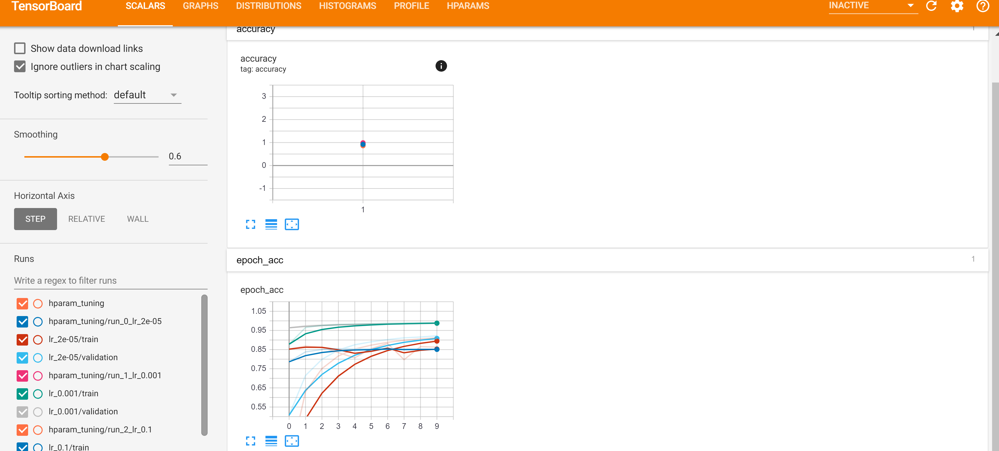

In [0]:
from IPython.display import Image
Image(filename='gdrive/My Drive/DeepLearning/plots/pa11.png', width=1000) 

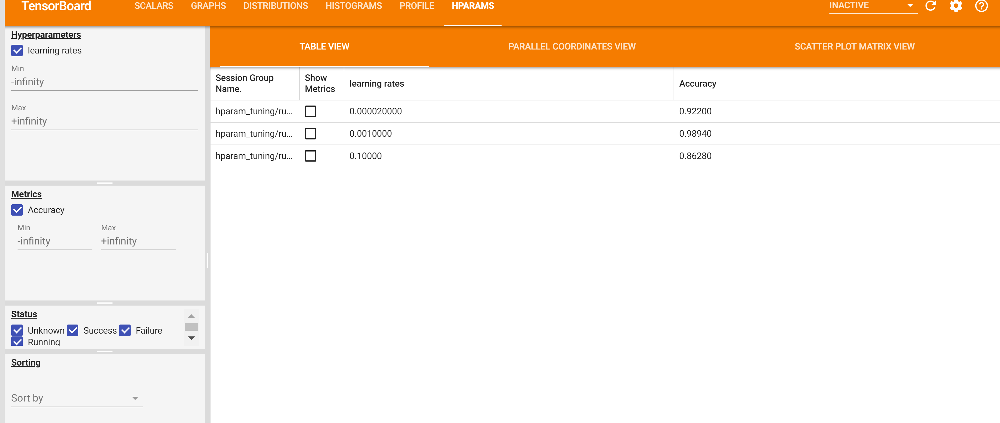

In [0]:
Image(filename='gdrive/My Drive/DeepLearning/plots/pa12.png', width=1000) 

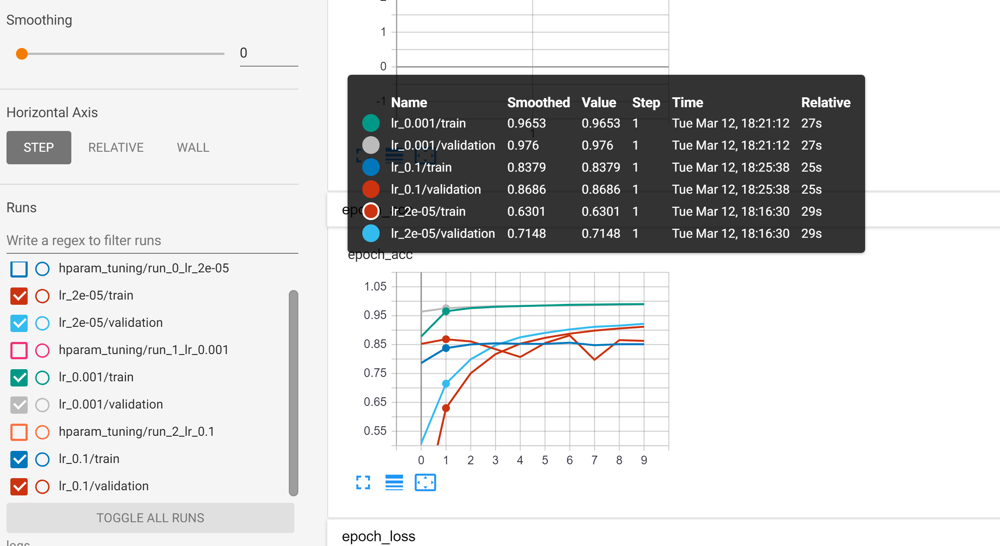

In [0]:
Image(filename='gdrive/My Drive/DeepLearning/plots/pa13.png', width=1000) 

Three different learning rates were tested in the experient. The best one among the three learning rates is 1e-3, which achieved the highest accuracy on the test set. When the learning rate is too small like 2e-5, the gradient descent can be slow. In the sampe 10 epochs, the accuracy under the learning rate of 2e-5 is lower than the accuracy under the learning rate of 1e-3. However, when  the learning rate is too large, such as 1e-1, the gradient descent can overshoot the minimum and fail to converge.

**Compare different activations**

In [0]:
activations = ['tanh', 'sigmoid', 'relu']

def create_summary(activations):
  activations_val = struct_pb2.ListValue().extend(activations)
  return hparams_summary.experiment_pb(
  hparam_infos=[
      api_pb2.HParamInfo(name='activations',
                        display_name='activations',
                        type=api_pb2.DATA_TYPE_STRING,
                        domain_discrete=activations_val)
  ],
  metric_infos=[
      api_pb2.MetricInfo(
        name=api_pb2.MetricName(
          tag='accuracy'),
        display_name='Accuracy'),
  ])

exp_summary = create_summary(activations)
dir = 'logs2/hparam_tuning'
root_logdir_writer = tf.summary.create_file_writer(dir)
with root_logdir_writer.as_default():
  tf.summary.import_event(tf.compat.v1.Event(summary=exp_summary).SerializeToString())

  
  
def build_model2(hparams):
  ac_type = hparams['activations']
  model = models.Sequential()
  model.add(layers.Conv2D(16, (3,3), activation=ac_type, input_shape=(28,28,1)))
  model.add(layers.MaxPooling2D((2,2)))
  model.add(layers.Conv2D(16, (3,3), activation=ac_type))
  model.add(layers.MaxPooling2D((2,2)))
  model.add(layers.Flatten())
  model.add(layers.Dense(32, activation=ac_type))
  model.add(layers.Dense(10, activation='softmax'))
  
  logdir = os.path.join("logs2",str(hparams['activations']))
  tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir, histogram_freq=1)
  
  model.compile(optimizer=optimizers.Adam(lr=1e-3),
               loss='sparse_categorical_crossentropy',
               metrics=['acc'])
  
  model.fit(x_train, y_train, epochs=10, batch_size=128, callbacks=[tensorboard_callback], validation_data=(x_test, y_test)) 
  _, accuracy = model.evaluate(x_test, y_test)
  return accuracy

def run(run_dir, hparams):
  writer = tf.summary.create_file_writer(run_dir)
  summary_start = hparams_summary.session_start_pb(hparams=hparams)

  with writer.as_default():
    accuracy = build_model2(hparams)
    summary_end = hparams_summary.session_end_pb(api_pb2.STATUS_SUCCESS)
      
    tf.summary.scalar('accuracy', accuracy, step=1, description="The accuracy")
    tf.summary.import_event(tf.compat.v1.Event(summary=summary_start).SerializeToString())
    tf.summary.import_event(tf.compat.v1.Event(summary=summary_end).SerializeToString())
  
  
session_num = 0
for ac in activations:
  hparams = {'activations':ac}
  print('--- Running training session %d' % (session_num + 1))
  print(hparams)
  run_name = "run_{}_ac_{}".format(session_num,ac)
  run("logs2/hparam_tuning/" + run_name, hparams)
  session_num += 1

--- Running training session 1
{'activations': 'tanh'}
Train on 60000 samples, validate on 10000 samples
Epoch 1/10
60000/60000 [==============================] - 33s 548us/sample - loss: 0.4210 - acc: 0.8905 - val_loss: 0.1371 - val_acc: 0.9604
Epoch 2/10
60000/60000 [==============================] - 33s 546us/sample - loss: 0.1071 - acc: 0.9700 - val_loss: 0.0730 - val_acc: 0.9798
Epoch 3/10
60000/60000 [==============================] - 32s 533us/sample - loss: 0.0719 - acc: 0.9793 - val_loss: 0.0560 - val_acc: 0.9832
Epoch 4/10
60000/60000 [==============================] - 33s 543us/sample - loss: 0.0562 - acc: 0.9837 - val_loss: 0.0490 - val_acc: 0.9850
Epoch 5/10
60000/60000 [==============================] - 33s 548us/sample - loss: 0.0465 - acc: 0.9866 - val_loss: 0.0455 - val_acc: 0.9852
Epoch 6/10
60000/60000 [==============================] - 32s 525us/sample - loss: 0.0402 - acc: 0.9882 - val_loss: 0.0431 - val_acc: 0.9855
Epoch 7/10
60000/60000 [=========================

In [0]:
%tensorboard --logdir logs2

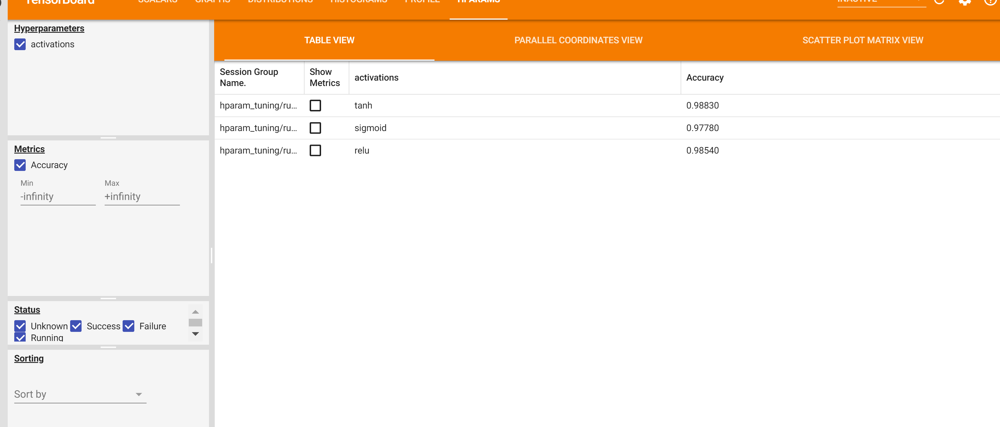

In [0]:
from IPython.display import Image
Image(filename='gdrive/My Drive/DeepLearning/plots/pa21.png', width=1000) 

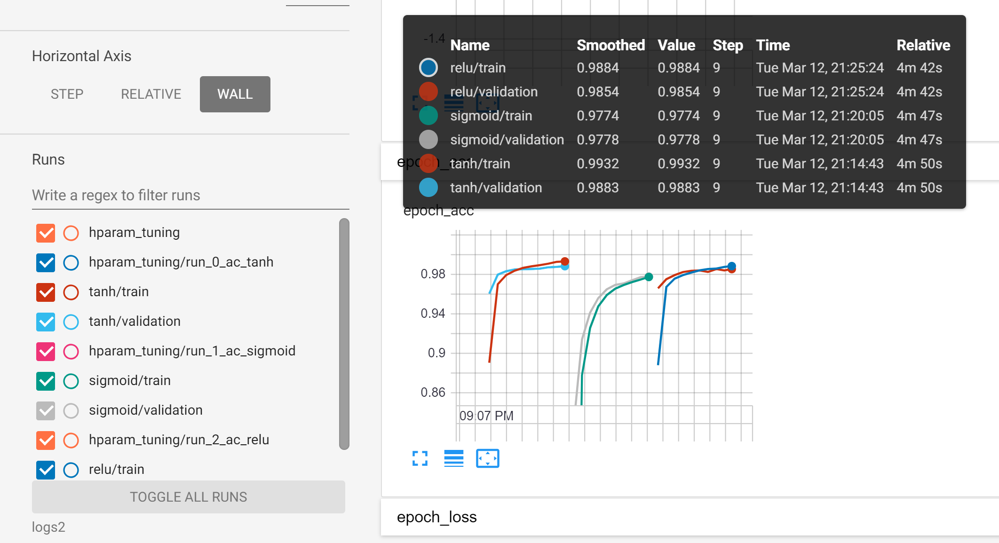

In [0]:
from IPython.display import Image
Image(filename='gdrive/My Drive/DeepLearning/plots/pa22.png', width=1000) 

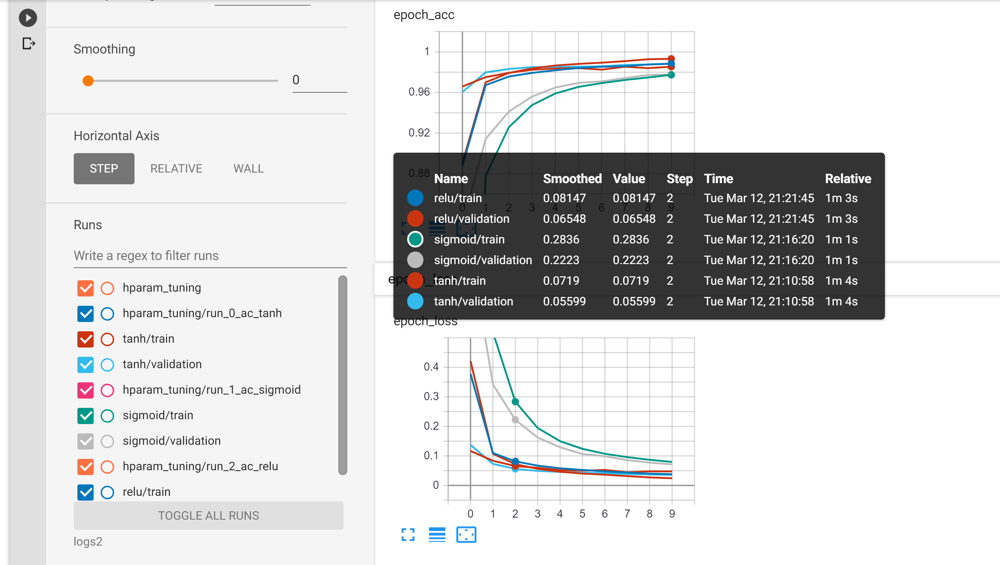

In [0]:
from IPython.display import Image
Image(filename='gdrive/My Drive/DeepLearning/plots/pa23.png', width=1000) 

Sigmoid activation function has a slow convergence compare with the other two optimizers. The output of the sigmoid activation isn't zero centered and is between 0 and 1 which may lead to vanishing gradient problem. The relu activation has the best performance in the three different optimizers regarding both the loss and accuracy on the test set. The gradient vanishing is avoided in relu but some weight will never update again once it becomes zero. Hyperbolic Tangent function, the tanh activation, could still suffer from vanishing gradient problem. But the output of tanh is zero centered and is between -1 and 1. In practice, the tanh activation function has better performance than the sigmoid function.

**Compare different optimizers**

In [0]:
optimizers = ['sgd', 'rmsprop', 'adam']

def create_summary(optimizers):
  optimizers_val = struct_pb2.ListValue().extend(optimizers)
  return hparams_summary.experiment_pb(
  hparam_infos=[
      api_pb2.HParamInfo(name='optimizers',
                        display_name='optimizers',
                        type=api_pb2.DATA_TYPE_STRING,
                        domain_discrete=optimizers_val)
  ],
  metric_infos=[
      api_pb2.MetricInfo(
        name=api_pb2.MetricName(
          tag='accuracy'),
        display_name='Accuracy'),
  ])

exp_summary = create_summary(optimizers)
dir = 'logs3/hparam_tuning'
root_logdir_writer = tf.summary.create_file_writer(dir)
with root_logdir_writer.as_default():
  tf.summary.import_event(tf.compat.v1.Event(summary=exp_summary).SerializeToString())

  
  
def build_model3(hparams):
  op_type = hparams['optimizers']
  ac_type='relu'
  model = models.Sequential()
  model.add(layers.Conv2D(16, (3,3), activation=ac_type, input_shape=(28,28,1)))
  model.add(layers.MaxPooling2D((2,2)))
  model.add(layers.Conv2D(16, (3,3), activation=ac_type))
  model.add(layers.MaxPooling2D((2,2)))
  model.add(layers.Flatten())
  model.add(layers.Dense(32, activation=ac_type))
  model.add(layers.Dense(10, activation='softmax'))
  
  logdir = os.path.join("logs3",str(hparams['optimizers']))
  tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir, histogram_freq=1)
  
  model.compile(optimizer=op_type,
               loss='sparse_categorical_crossentropy',
               metrics=['acc'])
  
  model.fit(x_train, y_train, epochs=10, batch_size=128, callbacks=[tensorboard_callback], validation_data=(x_test, y_test)) 
  _, accuracy = model.evaluate(x_test, y_test)
  return accuracy

def run(run_dir, hparams):
  writer = tf.summary.create_file_writer(run_dir)
  summary_start = hparams_summary.session_start_pb(hparams=hparams)

  with writer.as_default():
    accuracy = build_model3(hparams)
    summary_end = hparams_summary.session_end_pb(api_pb2.STATUS_SUCCESS)
      
    tf.summary.scalar('accuracy', accuracy, step=1, description="The accuracy")
    tf.summary.import_event(tf.compat.v1.Event(summary=summary_start).SerializeToString())
    tf.summary.import_event(tf.compat.v1.Event(summary=summary_end).SerializeToString())
  
  
session_num = 0
for op in optimizers:
  hparams = {'optimizers':op}
  print('--- Running training session %d' % (session_num + 1))
  print(hparams)
  run_name = "run_{}_op_{}".format(session_num,op)
  run("logs3/hparam_tuning/" + run_name, hparams)
  session_num += 1

--- Running training session 1
{'optimizers': 'sgd'}
Train on 60000 samples, validate on 10000 samples
Epoch 1/10
60000/60000 [==============================] - 32s 532us/sample - loss: 2.2954 - acc: 0.0858 - val_loss: 2.2721 - val_acc: 0.0919
Epoch 2/10
60000/60000 [==============================] - 33s 547us/sample - loss: 2.2510 - acc: 0.1403 - val_loss: 2.2206 - val_acc: 0.2087
Epoch 3/10
60000/60000 [==============================] - 33s 548us/sample - loss: 2.1870 - acc: 0.2674 - val_loss: 2.1365 - val_acc: 0.3402
Epoch 4/10
60000/60000 [==============================] - 33s 551us/sample - loss: 2.0682 - acc: 0.3977 - val_loss: 1.9647 - val_acc: 0.4697
Epoch 5/10
60000/60000 [==============================] - 33s 546us/sample - loss: 1.8110 - acc: 0.5352 - val_loss: 1.5918 - val_acc: 0.6053
Epoch 6/10
60000/60000 [==============================] - 33s 542us/sample - loss: 1.3602 - acc: 0.6516 - val_loss: 1.0992 - val_acc: 0.7101
Epoch 7/10
60000/60000 [===========================

In [0]:
%tensorboard --logdir logs3

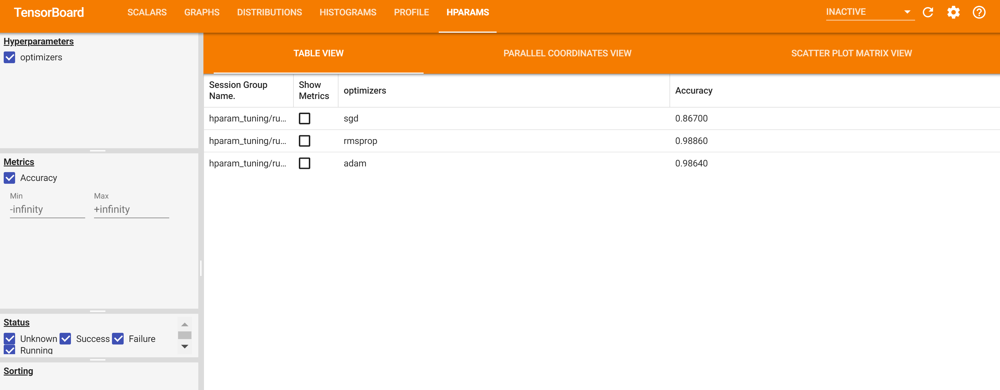

In [0]:
from IPython.display import Image
Image(filename='gdrive/My Drive/DeepLearning/plots/pa31.png', width=1000) 

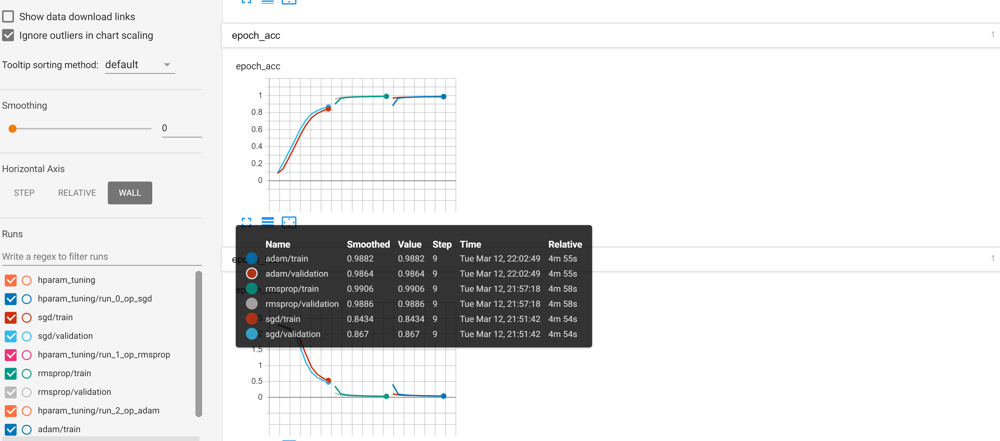

In [0]:
from IPython.display import Image
Image(filename='gdrive/My Drive/DeepLearning/plots/pa34.png', width=1500) 

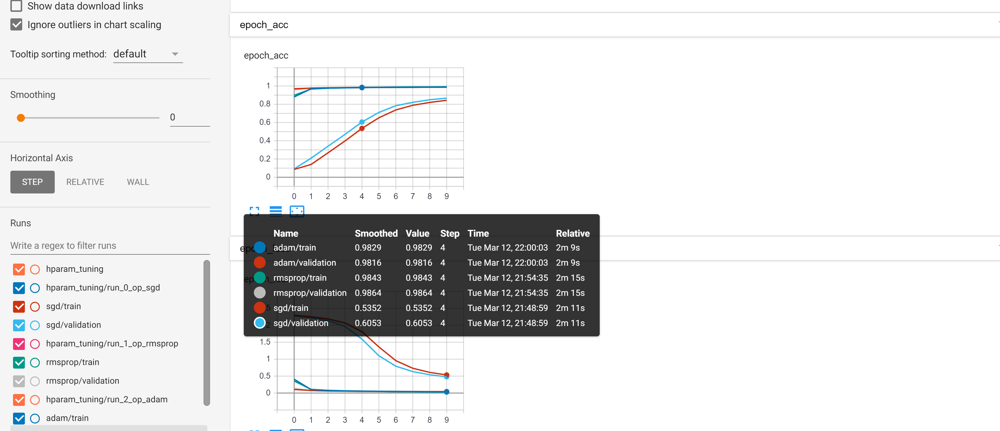

In [0]:
Image(filename='gdrive/My Drive/DeepLearning/plots/pa333.png', width=1500) 

Adam optimizer and RMSprop optimizer are both adaptive learning rate methods, SGD updates the parameters fast but with high parameter variance. The performance of Adam and RMSprop are better than the SGD. And the accuracy obtained by the RMSprop is slightly higher than the Adam while the Aam optimizer updates weights faster than the others.

**Compare different weight initialization strategies**

In [6]:
initializers = ['random_uniform','zeros', 'random_normal']
def create_summary(initializers):
  initializers_val = struct_pb2.ListValue().extend(initializers)
  return hparams_summary.experiment_pb(
  hparam_infos=[
      api_pb2.HParamInfo(name='initializers',
                        display_name='initializers',
                        type=api_pb2.DATA_TYPE_STRING,
                        domain_discrete=initializers_val)
  ],
  metric_infos=[
      api_pb2.MetricInfo(
        name=api_pb2.MetricName(
          tag='accuracy'),
        display_name='Accuracy'),
  ])

exp_summary = create_summary(initializers)
dir = 'logs4/hparam_tuning'
root_logdir_writer = tf.summary.create_file_writer(dir)
with root_logdir_writer.as_default():
  tf.summary.import_event(tf.compat.v1.Event(summary=exp_summary).SerializeToString())

  
  
def build_model4(hparams):
  op_type = 'rmsprop'
  ac_type='relu'
  init_type = hparams['initializers']
  model = models.Sequential()
  model.add(layers.Conv2D(16, (3,3), activation=ac_type, input_shape=(28,28,1),
           kernel_initializer=init_type, bias_initializer=init_type))
  model.add(layers.MaxPooling2D((2,2)))
  model.add(layers.Conv2D(16, (3,3), activation=ac_type,
           kernel_initializer=init_type, bias_initializer=init_type))
  model.add(layers.MaxPooling2D((2,2)))
  model.add(layers.Flatten())
  model.add(layers.Dense(32, activation=ac_type,
           kernel_initializer=init_type, bias_initializer=init_type))
  model.add(layers.Dense(10, activation='softmax'))
  
  logdir = os.path.join("logs4",str(hparams['initializers']))
  tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir, histogram_freq=1)
  
  model.compile(optimizer=op_type,
               loss='sparse_categorical_crossentropy',
               metrics=['acc'])
  
  model.fit(x_train, y_train, epochs=10, batch_size=128, callbacks=[tensorboard_callback], validation_data=(x_test, y_test)) 
  _, accuracy = model.evaluate(x_test, y_test)
  return accuracy

def run(run_dir, hparams):
  writer = tf.summary.create_file_writer(run_dir)
  summary_start = hparams_summary.session_start_pb(hparams=hparams)

  with writer.as_default():
    accuracy = build_model4(hparams)
    summary_end = hparams_summary.session_end_pb(api_pb2.STATUS_SUCCESS)
      
    tf.summary.scalar('accuracy', accuracy, step=1, description="The accuracy")
    tf.summary.import_event(tf.compat.v1.Event(summary=summary_start).SerializeToString())
    tf.summary.import_event(tf.compat.v1.Event(summary=summary_end).SerializeToString())
  
  
session_num = 0
for init in initializers:
  hparams = {'initializers':init}
  print('--- Running training session %d' % (session_num + 1))
  print(hparams)
  run_name = "run_{}_init_{}".format(session_num,init)
  run("logs4/hparam_tuning/" + run_name, hparams)
  session_num += 1

--- Running training session 1
{'initializers': 'random_uniform'}
Train on 60000 samples, validate on 10000 samples
Epoch 1/10
60000/60000 [==============================] - 31s 518us/sample - loss: 0.4845 - acc: 0.8532 - val_loss: 0.1423 - val_acc: 0.9578
Epoch 2/10
60000/60000 [==============================] - 31s 522us/sample - loss: 0.1238 - acc: 0.9628 - val_loss: 0.0790 - val_acc: 0.9741
Epoch 3/10
60000/60000 [==============================] - 31s 520us/sample - loss: 0.0868 - acc: 0.9739 - val_loss: 0.0654 - val_acc: 0.9791
Epoch 4/10
60000/60000 [==============================] - 31s 515us/sample - loss: 0.0688 - acc: 0.9780 - val_loss: 0.0582 - val_acc: 0.9816
Epoch 5/10
60000/60000 [==============================] - 31s 518us/sample - loss: 0.0589 - acc: 0.9818 - val_loss: 0.0484 - val_acc: 0.9849
Epoch 6/10
60000/60000 [==============================] - 31s 519us/sample - loss: 0.0517 - acc: 0.9843 - val_loss: 0.0537 - val_acc: 0.9823
Epoch 7/10
60000/60000 [==============

In [10]:
%tensorboard --logdir logs4

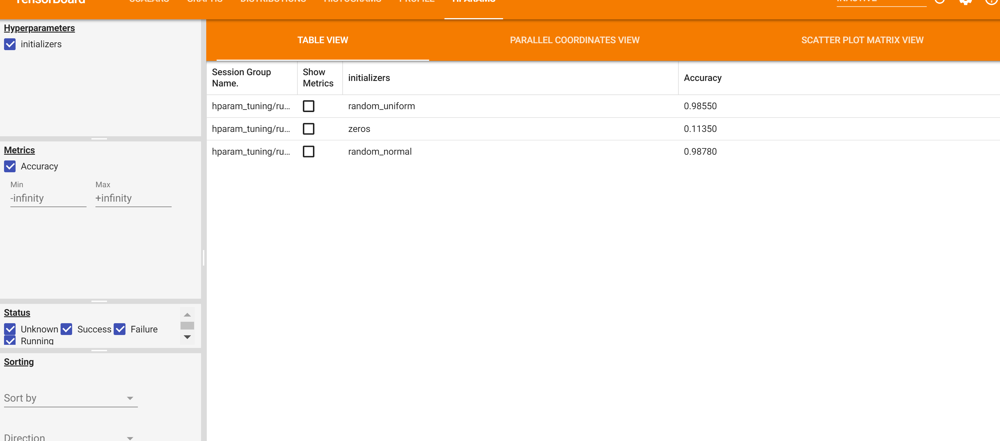

In [15]:
Image(filename='gdrive/My Drive/DeepLearning/plots/pa411.png', width=1000) 

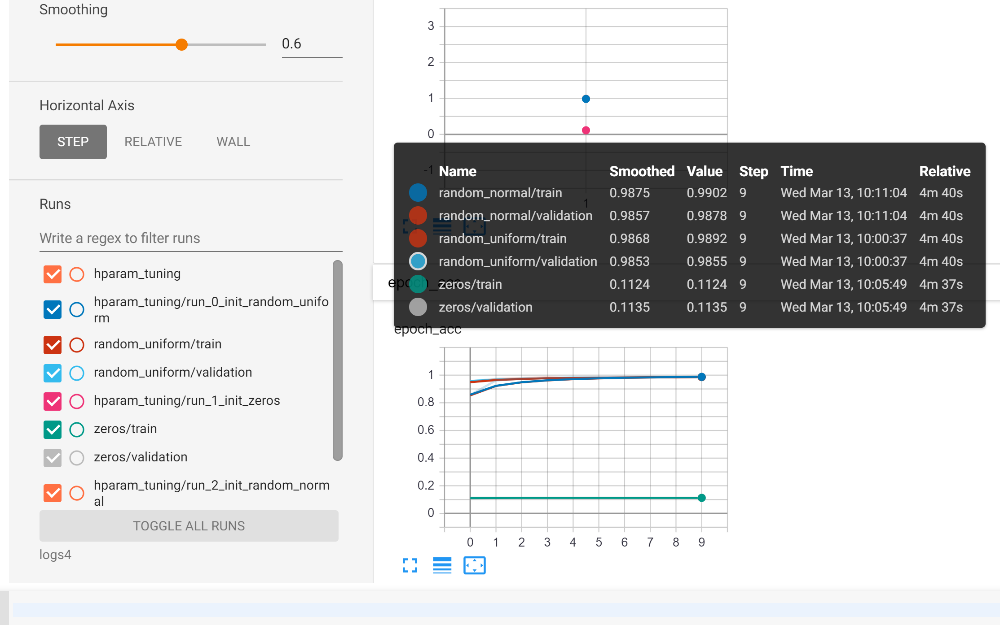

In [16]:
Image(filename='gdrive/My Drive/DeepLearning/plots/pa422.png', width=1500) 

When the weights are initialized to zeros and the relu activation function is used, the weights will not be updated. The other two weights initialization strategies, the random norm initializer and the random uniform initializer, both randomly initialize the weights by some distribution. The accuracy on the test set obtained by these two strategies are similar in the experient. But the initialization strategy could be very important. It would be much harder to train the model if the weights are improperly initialized.